In [1]:
# import libraries
import numpy as np

import torch
import torch.nn as nn
import torch.nn.functional as F

# NEW! for doing PCA on the model output
from sklearn.decomposition import PCA

import matplotlib.pyplot as plt
from IPython import display
display.set_matplotlib_formats('svg')

/tmp/ipykernel_60866/2233319632.py:13: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  display.set_matplotlib_formats('svg')


# Import and process the data

In [2]:
data = np.loadtxt(open('train_mnist.csv','rb'),delimiter=',',skiprows=1)
# we'll use the labels for matching with the latent code
labels = data[:,0]
data   = data[:,1:]

# normalize the data to a range of [0 1]
dataNorm = data / np.max(data)

# convert to tensor
dataT = torch.tensor( dataNorm ).float()

# Create the DL model

In [3]:
# create a class for the model
def createTheMNISTAE():

  class aenet(nn.Module):
    def __init__(self):
      super().__init__()

      ### input layer
      self.input = nn.Linear(784,150)
      
      ### encoder layer
      self.enc = nn.Linear(150,15)

      ### latent layer
      self.lat = nn.Linear(15,150)

      ### decoder layer
      self.dec = nn.Linear(150,784)

    # forward pass
    def forward(self,x):
      x = F.relu( self.input(x) )
      
      # NEW! output the hidden-layer activation
      codex = F.relu( self.enc(x) )
      
      x = F.relu( self.lat(codex) )
      y = torch.sigmoid( self.dec(x) )
      return y,codex
  
  # create the model instance
  net = aenet()
  
  # loss function
  lossfun = nn.MSELoss()

  # optimizer
  optimizer = torch.optim.Adam(net.parameters(),lr=.001)

  return net,lossfun,optimizer

In [4]:
# test the model with a bit of data
net,lossfun,optimizer = createTheMNISTAE()

X = dataT[:5,:]
yHat = net(X)

print('Input shape:')
print(X.shape)
print(' ')

# yHat is now a tuple
print(type(yHat),len(yHat))
print(' ')

print('Shape of model output:')
print(yHat[0].shape)
print(' ')

print('Shape of encoding layer output:')
print(yHat[1].shape)

Input shape:
torch.Size([5, 784])
 
<class 'tuple'> 2
 
Shape of model output:
torch.Size([5, 784])
 
Shape of encoding layer output:
torch.Size([5, 15])


# Create a function that trains the model

In [5]:
def function2trainTheModel():

  # number of epochs
  numepochs = 10000
  
  # create a new model
  net,lossfun,optimizer = createTheMNISTAE()

  # initialize losses
  losses = torch.zeros(numepochs)


  # loop over epochs
  for epochi in range(numepochs):

    # select a random set of images
    randomidx = np.random.choice(dataT.shape[0],size=32)
    X = dataT[randomidx,:]

    # forward pass and loss
    yHat = net(X)[0] # NEW! here we only care about the final model output
    loss = lossfun(yHat,X)

    # backprop
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    # losses in this epoch
    losses[epochi] = loss.item()
  # end epochs

  # function output
  return losses,net

# Run the model and show the results!

Final loss: 0.0149


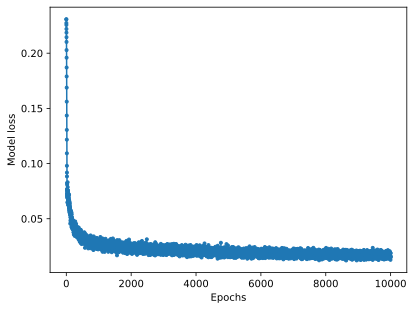

In [6]:
# train the model
losses,net = function2trainTheModel()
print(f'Final loss: {losses[-1]:.4f}')

# visualize the losses
plt.plot(losses,'.-')
plt.xlabel('Epochs')
plt.ylabel('Model loss')
plt.show()

# Inspect the latent "code" of the model

- **Latent Layer Exploration**: This section of code examines the activations within the latent layer of the neural network after processing the entire MNIST dataset. It aims to understand the characteristics and distribution of the latent space, which represents a compressed knowledge of the data.

- **Activation Analysis**: After pushing the dataset through the network (`net`), the activations of the latent layer (`latent`) are extracted alongside the reconstructed outputs (`yHat`). The sizes of both the output and latent activations are printed, providing insight into the dimensions of the network's inner workings and output.

- **Distribution Visualization**: A histogram of the latent activations is generated to visualize the distribution of values within the latent space. This plot offers a macroscopic view of how the network encodes the input data into a compact representation, indicating the spread and density of activation values.

- **Latent Activations Heatmap**: The second plot displays a heatmap of all latent activations across the dataset. Each row corresponds to an image in the dataset, and each column represents a node in the latent layer. This visualization helps identify patterns in the latent space, such as which nodes are more active and how they respond to different inputs.

The exploration of the latent layer's output provides valuable insights into how the autoencoder compresses data and what features it deems important, informing further refinements and interpretations of the model's learning mechanisms.


In [ ]:
# output the latent layer

# push through the entire dataset
yHat,latent = net(dataT)

# print sizes
print(yHat.shape)
print(latent.shape)

# what does it look like?
fig,ax = plt.subplots(1,2,figsize=(15,5))

ax[0].hist(latent.flatten().detach(),100)
ax[0].set_xlabel('Latent activation value')
ax[0].set_ylabel('Count')
ax[0].set_title('Distribution of latent units activations')

ax[1].imshow(latent.detach(),aspect='auto',vmin=0,vmax=10)
ax[1].set_xlabel('Latent node')
ax[1].set_ylabel('Image number')
ax[1].set_title('All latent activations')

plt.show()

torch.Size([60000, 784])
torch.Size([60000, 15])


- **Latent Layer Analysis Across Digit Types**: This segment of code investigates how the autoencoder model internally represents different digits (0 through 9) by examining the average activation levels of the latent layer for each digit type. This exploration provides insights into the model's feature extraction capabilities and how it distinguishes between various digit categories.

- **Activation Averages Computation**: For each of the ten digit categories, the code identifies all instances of that digit within the dataset, calculates the average activation of the latent layer nodes for these instances, and stores these averages in a matrix (`sourcecode`). This process results in a profile of average latent activations for each digit type, highlighting the model's response patterns to different numerical inputs.

- **Visualization of Internal Representations**: A plot is generated to display the average activation of each latent node across the ten digit types. Each digit is represented by a distinct line on the graph, allowing for a visual comparison of the model's latent space activations in response to different digits.

- **Interpretation of Model Behavior**: The resulting plot serves as a window into the model's internal representations, offering a visual summary of how distinct or overlapping the latent activations are for each digit. High variability in activation patterns across digits may indicate that the model effectively utilizes its latent space to differentiate between digit types, while similar patterns across different digits could suggest areas where the model may struggle to distinguish between certain numbers.

This analysis aids in understanding the nuances of the autoencoder's feature extraction process, highlighting the sophistication with which it encodes and distinguishes between the input digit images based on their latent activations.


C:\Users\fafzali\AppData\Local\Temp\ipykernel_39720\3440519343.py:14: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:264.)
  sourcecode[:,i] = torch.mean(latent[digidx,:],axis=1).detach()


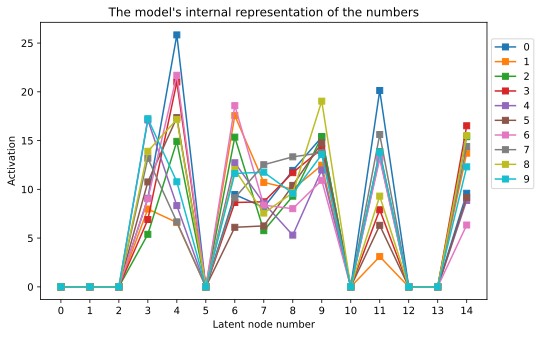

In [8]:
# compute the average latent activation for each digit type

# initialize output matrix (latent shape by 10 digits)
sourcecode = np.zeros((latent.shape[1],10))


# loop over digit categories
for i in range(10):

  # find all pictures of this category
  digidx = np.where(labels==i)

  # average the latent layer output
  sourcecode[:,i] = torch.mean(latent[digidx,:],axis=1).detach()


# let's see what it looks like!
fig = plt.figure(figsize=(8,5))

plt.plot(sourcecode,'s-')
plt.legend(range(10),loc=(1.01,.4))
plt.xticks(range(15))
plt.xlabel('Latent node number')
plt.ylabel('Activation')
plt.title("The model's internal representation of the numbers")
plt.show()

# Explore the reduced-compressed space with PCA

- **Principal Component Analysis (PCA) on Data and Latent Codes**: The code performs PCA on two datasets: the original data (`data`) and the latent representations (`latent`) obtained from an autoencoder. The purpose is to compare how much variance each set of principal components explains, providing insights into the data's structure and the autoencoder's compression efficiency.

- **Eigenspectra Visualization**: A scree plot, or eigenspectra plot, is generated to visually compare the explained variance ratios of the principal components derived from both the original data and the latent codes. The plot displays the percentage of variance explained by the first 15 components of each PCA fit, highlighting the dimensionality reduction and feature extraction capabilities of the autoencoder relative to the original data's complexity.

- **Comparative Analysis of Data and Code Representations**: By plotting the explained variance ratio for PCA components of both the original data and the latent codes, the graph facilitates a direct comparison between the intrinsic dimensionality of the data and the efficiency of the latent representation in capturing the data's variance. This analysis is crucial for understanding the effectiveness of the latent space in representing the key features of the data.

- **Insights into Dimensionality Reduction**: The scree plot serves as a powerful tool for assessing the extent to which the autoencoder has managed to compress and encode the essential information from the original data into a lower-dimensional latent space. Differences in the explained variance ratios between the original data PCA and the latent codes PCA can indicate how well the autoencoder captures the data's underlying structure and variance within a more compact latent representation.

This markdown content provides a concise explanation of conducting and interpreting PCA on both the original dataset and the autoencoder's latent representations, offering insights into the autoencoder's compression and feature extraction performance.


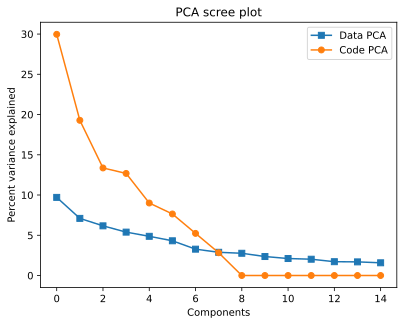

In [9]:
# compute and fit the PCA
pcaData = PCA(n_components=15).fit(data) # 15 components to match latent, but it's just to speed computation time
pcaCode = PCA(               ).fit(latent.detach())


# plot the eigenspectra (scree plot)
plt.plot(100*pcaData.explained_variance_ratio_,'s-',label='Data PCA')
plt.plot(100*pcaCode.explained_variance_ratio_,'o-',label='Code PCA')
plt.xlabel('Components')
plt.ylabel('Percent variance explained')
plt.title('PCA scree plot')
plt.legend()
plt.show()

- **PCA Projection Analysis**: The code performs Principal Component Analysis (PCA) on both the original dataset (`data`) and the latent representations (`latent`) produced by an autoencoder, then projects these onto the axes defined by the first two principal components (PC1 and PC2). This process aims to visualize the data's structure and the effectiveness of the latent representations in capturing the variance and separation between different classes.

- **Visualization by Digit Category**: In two separate subplots, each digit category (0 through 9) is plotted according to its projection onto the first two principal component axes. This allows for the visual inspection of how well different digit categories are separated in both the original data space and the latent space. The use of distinct markers for each digit category facilitates the comparison of clustering and separation patterns across the two PCA projections.

- **Comparative Display of Data and Latent Space Separation**: The first subplot titled 'PCA of data' displays the projection of the original data, while the second subplot titled 'PCA of latent code' shows the projection of the latent representations. This side-by-side comparison helps in assessing the dimensionality reduction and feature extraction capabilities of the autoencoder, particularly in terms of preserving the separability of different digit categories within a reduced-dimensional space.

- **Insights into Dimensionality Reduction and Feature Extraction**: The plots provide insights into how the autoencoder's latent space captures the essential features of the data, as indicated by the clustering of digit categories. By comparing the separation patterns in the PCA of data with those in the PCA of latent code, one can infer the degree to which the autoencoder retains or enhances the separability of the digit categories in its compressed representation.

This markdown content outlines the process and objectives of comparing the PCA projections of the original dataset and the autoencoder's latent codes, highlighting the autoencoder's ability to preserve or enhance class separability in a lower-dimensional space.


In [10]:
# compute the projection of the data onto the PC axes
scoresData = pcaData.fit_transform(data)
scoresCode = pcaCode.fit_transform(latent.detach())

# plot the data separately per number
fig,ax = plt.subplots(1,2,figsize=(15,5))

for lab in range(10):
  ax[0].plot(scoresData[labels==lab,0],scoresData[labels==lab,1],'o',markersize=3,alpha=.4)
  ax[1].plot(scoresCode[labels==lab,0],scoresCode[labels==lab,1],'o',markersize=3,alpha=.4)

for i in range(2):
  ax[i].set_xlabel('PC1 projection')
  ax[i].set_ylabel('PC2 projection')
  ax[i].legend(range(10))

ax[0].set_title('PCA of data')
ax[1].set_title('PCA of latent code')
plt.show()

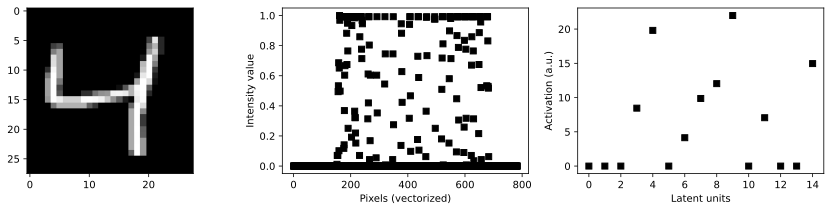

In [12]:
# This cell is not important! It's just the code I used to make the figure in the slide. I decided to leave it here FYI.

fig,ax = plt.subplots(1,3,figsize=(15,3))

ax[0].imshow(dataT[2,:].view(28,28),cmap='gray')

ax[1].plot(dataT[0,:],'ks')
ax[1].set_xlabel('Pixels (vectorized)')
ax[1].set_ylabel('Intensity value')

ax[2].plot(latent[0,:].detach(),'ks')
ax[2].set_xlabel('Latent units')
ax[2].set_ylabel('Activation (a.u.)')

plt.show()